# Infer Population Model Parameters from Individuals in Lung Cancer Control Group

In [1]:
import os

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pints
import xarray as xr

import erlotinib as erlo

## Show control group data

In [2]:
# Get data
data = erlo.DataLibrary().lung_cancer_control_group()

# Create scatter plot
fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')

# Show figure
fig.show()

**Figure 1:** Visualisation of the measured tumour growth in 8 mice with patient-derived lung cancer implants.

## Build model

In [3]:
# Define mechanistic model
path = erlo.ModelLibrary().tumour_growth_inhibition_model_koch_reparametrised()
mechanistic_model = erlo.PharmacodynamicModel(path)
mechanistic_model.set_parameter_names(names={
    'myokit.tumour_volume': 'Tumour volume in cm^3',
    'myokit.critical_volume': 'Critical volume in cm^3',
    'myokit.drug_concentration': 'Drug concentration in mg/L',
    'myokit.kappa': 'Potency in L/mg/day',
    'myokit.lambda': 'Exponential growth rate in 1/day'})
mechanistic_model.set_output_names({
    'myokit.tumour_volume': 'Tumour volume'})

# Define error model
error_model = erlo.ConstantAndMultiplicativeGaussianErrorModel()

# Define population model
population_model = [
    erlo.LogNormalModel(),  # Initial tumour volume
    erlo.LogNormalModel(),  # Critical tumour volume
    erlo.LogNormalModel(),  # Tumour growth rate
    erlo.PooledModel(),     # Base noise
    erlo.PooledModel()]     # Relative noise

# Build model
problem = erlo.ProblemModellingController(
    mechanistic_model, error_model)
problem.fix_parameters({
    'Drug concentration in mg/L': 0,
    'Potency in L/mg/day': 0})
problem.set_population_model(population_model)

## Prior predictive checks

### Population model

In [44]:
# Define prior distribution
log_priors = [
    # pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Mean Initial tumour volume
    # pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Initial tumour volume
    pints.GaussianLogPrior(mean=-1, sd=0.5),                             # Mean log Initial tumour volume
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.2, a=0, b=np.inf),    # Std. log Initial tumour volume
    # pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Mean Critical tumour volume
    # pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Critical tumour volume
    pints.GaussianLogPrior(mean=0, sd=0.5),                              # Mean log Critical tumour volume
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.2, a=0, b=np.inf),    # Std. log Critical tumour volume
    # pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Mean Growth rate
    # pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Growth rate
    pints.GaussianLogPrior(mean=-1.5, sd=0.5),                             # Mean log Growth rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.2, a=0, b=np.inf),    # Std. log Growth rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Pooled Sigma base
    pints.TruncatedGaussianLogPrior(mean=1, sd=0.5, a=0, b=np.inf)]      # Pooled Sigma rel.
log_prior = pints.ComposedLogPrior(*log_priors)

# Define prior predictive model
predictive_model = problem.get_predictive_model()
model = erlo.PriorPredictiveModel(predictive_model, log_prior)

# Sample from prior predictive model
seed = 42
n_samples = 100
times = np.linspace(0, 30)
samples = model.sample(times, n_samples, seed)

# Visualise prior predictive model
fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

**Figure 3:** Approximate prior predictive model for the tumour growth in a population over time. The shaded areas indicate the 30%, 60% and 90% bulk of the prior predictive model (from dark to light). The prior predictive model was approximated by sampling 1000 parameters from the prior distribution, and subsequent sampling of 50 equidistant time points from the predictive model for each parameter set.

## Find posterior probability distribution

In [45]:
# # Define log-posterior
# problem.set_data(data)
# problem.set_log_prior(log_priors)
# log_posterior = problem.get_log_posterior()

# Set up sampling controller
sampler = erlo.SamplingController(log_posterior)
sampler.set_sampler(pints.HamiltonianMCMC)
sampler.set_transform(transform=pints.ComposedTransformation(
    pints.LogTransformation(n_parameters=8),  # Individual parameters
    pints.IdentityTransformation(1),          # Mean log population
    pints.LogTransformation(n_parameters=9),  # Std log population + individual parameters
    pints.IdentityTransformation(1),          # Mean log population
    pints.LogTransformation(n_parameters=9),  # Std log population + individual parameters
    pints.IdentityTransformation(1),          # Mean log population
    pints.LogTransformation(n_parameters=3))) # Std log population + Noise parameters
sampler.set_n_runs(5)

# Run sampling
n_iterations = 5000
hyperparameters = [15, 0.1]
posterior_samples = sampler.run(
    n_iterations=n_iterations, hyperparameters=hyperparameters, show_progress_bar=True, log_to_screen=True)

Using Hamiltonian Monte Carlo
Generating 5 chains.
Running in parallel with 5 worker processess.
Iter. Eval. Accept.   Accept.   Accept.   Accept.   Accept.   Time m:s
0     5      0         0         0         0         0          0:16.6
1     80     0         0         0.333     0.333     0          0:16.7
2     155    0         0.25      0.25      0.25      0.25       0:16.8
3     230    0.2       0.4       0.2       0.4       0.2        0:16.9
20    1505   0.273     0.318     0.136     0.136     0.227      0:18.8
40    3005   0.238     0.262     0.119     0.119     0.238      0:36.7
60    4505   0.355     0.306     0.145     0.0968    0.226      0:39.0
80    6005   0.341     0.304878  0.159     0.134     0.207      0:56.9
100   7505   0.304     0.275     0.167     0.127451  0.176      1:15.0
120   9005   0.262     0.295082  0.18      0.115     0.204918   1:17.3
140   10505  0.239     0.31      0.218     0.141     0.19       1:35.4
160   12005  0.228     0.333     0.253     0.16    

Took a long time to run, so we ran inference remotely and load samples from disk.

In [5]:
# Import parameters from disk
path = os.getcwd()
path = os.path.join(path, 'posteriors/steps_15_size_point1')
filenames = [
    'chain_parameters_0.csv',
    'chain_parameters_1.csv',
    'chain_parameters_2.csv',
    'chain_parameters_3.csv',
    'chain_parameters_4.csv']
temp = []
for filename in filenames:
    temp.append(np.genfromtxt(
        os.path.join(path, filename),
        delimiter=',',
        skip_header=1))

# Reshape samples to standard pints format
n_chains = len(temp)
n_iterations, n_parameters = temp[0].shape
samples = np.empty(shape=(n_chains, n_iterations, n_parameters))
for index, s in enumerate(temp):
    samples[index, ...] = s

# Format samples to xarray.Dataset
problem.set_data(data)
problem.set_log_prior(log_priors)
log_posterior = problem.get_log_posterior()
sampler = erlo.SamplingController(log_posterior)
names = log_posterior.get_parameter_names()
ids = log_posterior.get_id()
posterior_samples = sampler._format_chains(samples, names, ids, None)

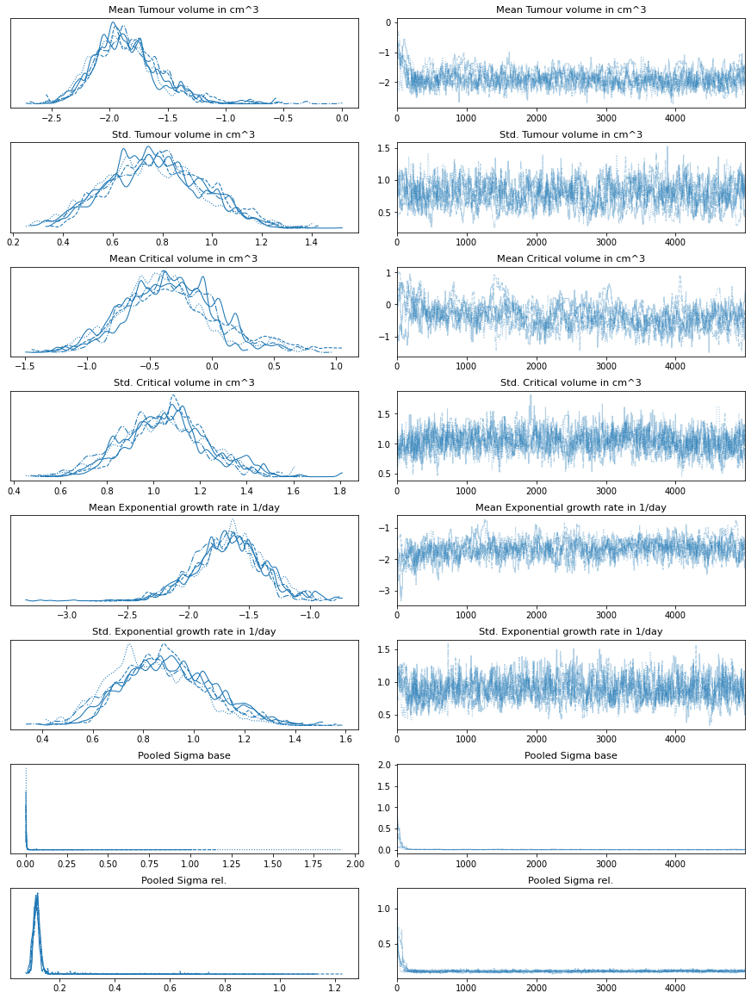

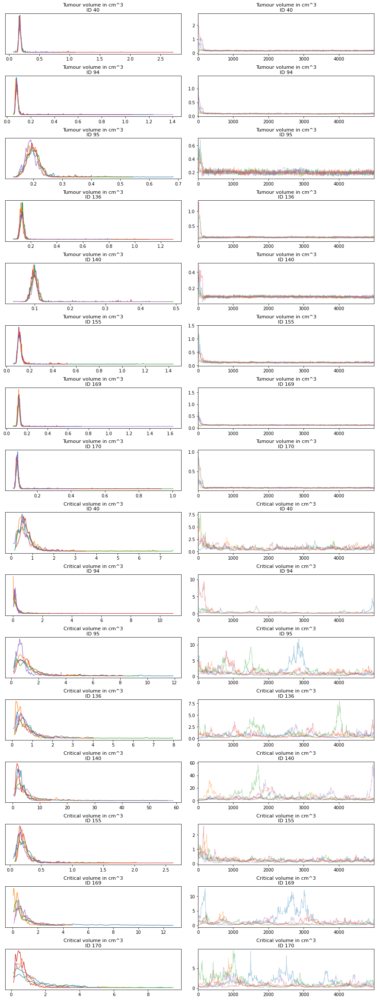

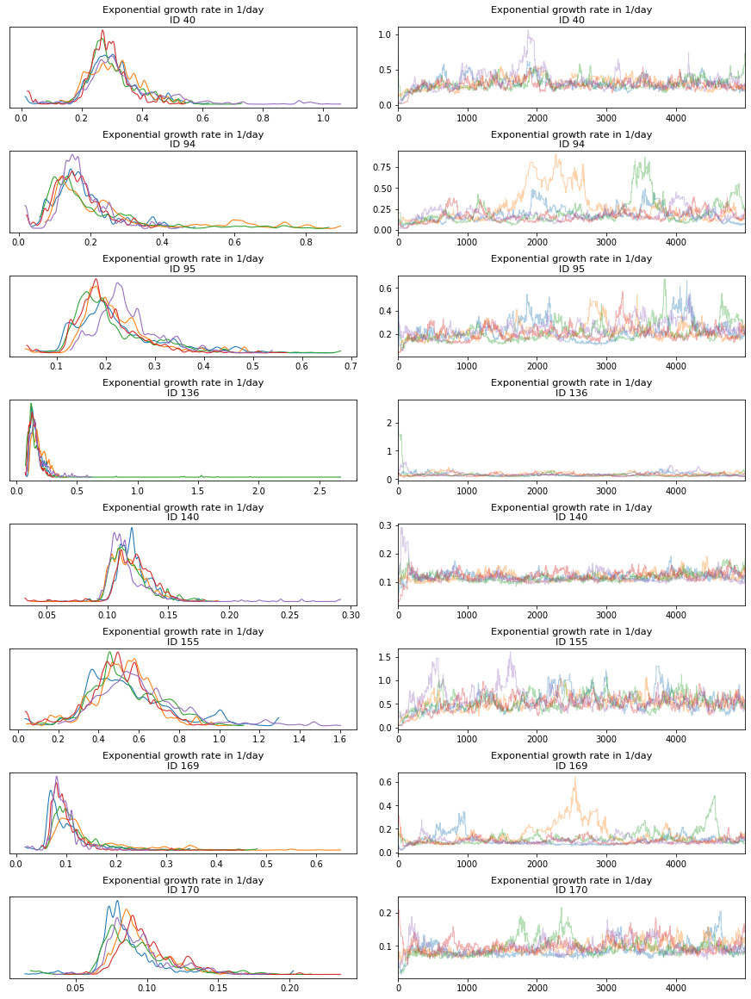

In [46]:
az.plot_trace(
    posterior_samples, 
    var_names=[
        'Mean Tumour volume in cm^3',
        'Std. Tumour volume in cm^3',
        'Mean Critical volume in cm^3',
        'Std. Critical volume in cm^3',
        'Mean Exponential growth rate in 1/day',
        'Std. Exponential growth rate in 1/day',
        'Pooled Sigma base',
        'Pooled Sigma rel.'])
plt.show()

az.plot_trace(
    posterior_samples, 
    var_names=[
        'Tumour volume in cm^3',
        'Critical volume in cm^3'],
    compact=False)
plt.show()

az.plot_trace(
    posterior_samples, 
    var_names=[
        'Exponential growth rate in 1/day'],
    compact=False)
plt.show()

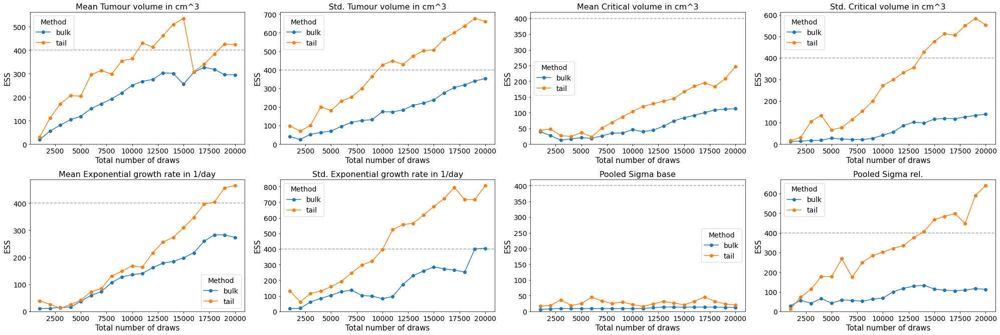

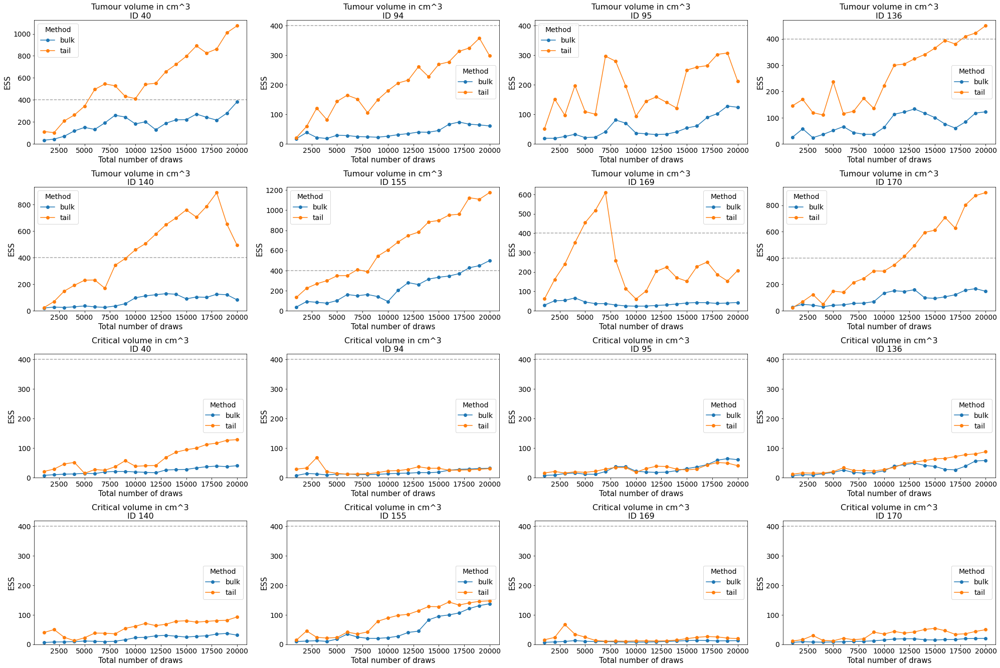

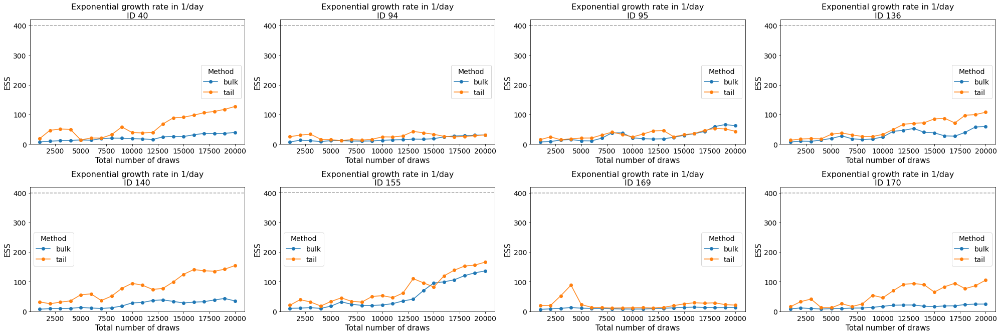

In [47]:
warmup = 1000
thinning_ratio = 1

az.plot_ess(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)),
    kind='evolution',
    var_names=[
        'Mean Tumour volume in cm^3',
        'Std. Tumour volume in cm^3',
        'Mean Critical volume in cm^3',
        'Std. Critical volume in cm^3',
        'Mean Exponential growth rate in 1/day',
        'Std. Exponential growth rate in 1/day',
        'Pooled Sigma base',
        'Pooled Sigma rel.'])
plt.show()

az.plot_ess(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), 
    var_names=[
        'Tumour volume in cm^3',
        'Critical volume in cm^3'],
    kind='evolution')
plt.show()

az.plot_ess(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), 
    var_names=[
        'Exponential growth rate in 1/day'],
    kind='evolution')
plt.show()

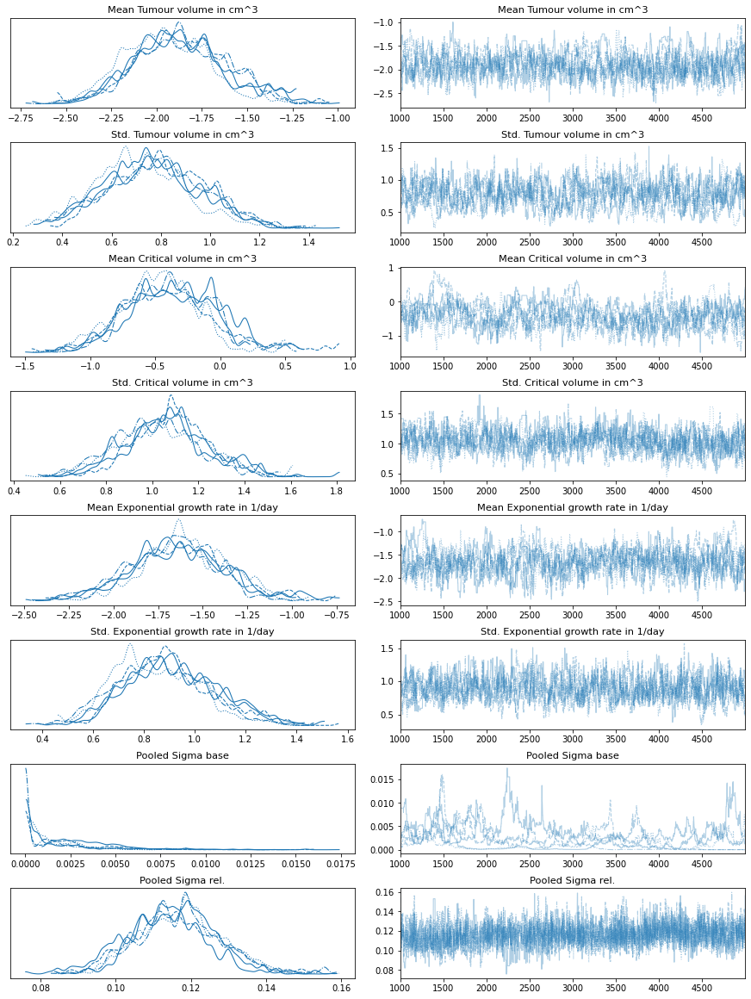

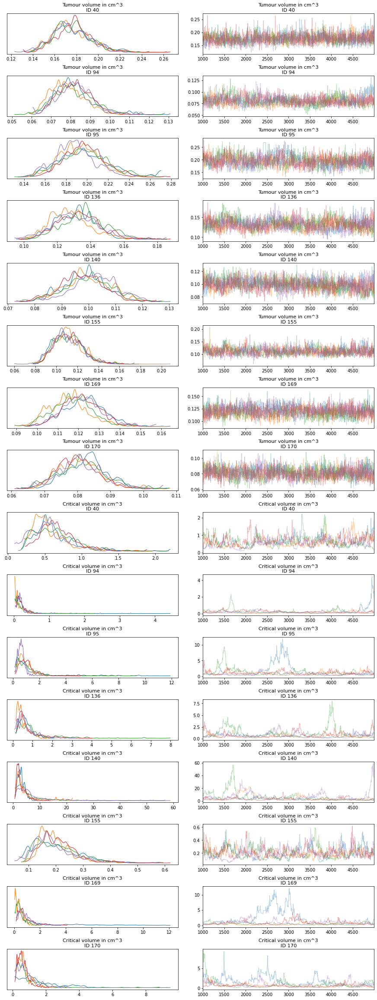

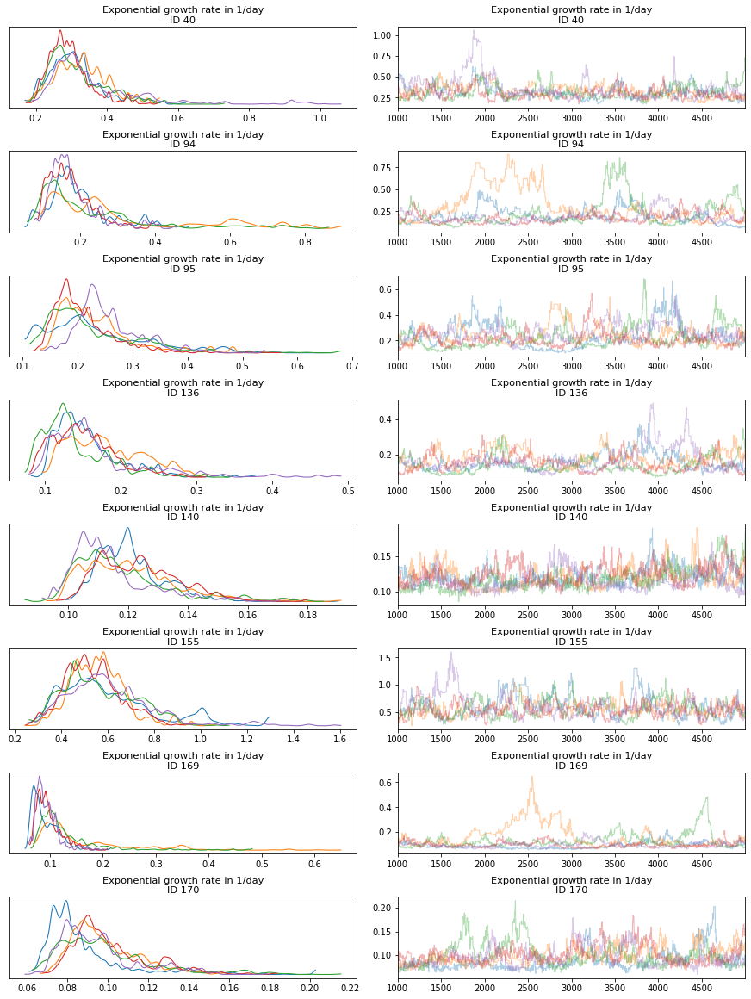

In [48]:
az.plot_trace(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), 
    var_names=[
        'Mean Tumour volume in cm^3',
        'Std. Tumour volume in cm^3',
        'Mean Critical volume in cm^3',
        'Std. Critical volume in cm^3',
        'Mean Exponential growth rate in 1/day',
        'Std. Exponential growth rate in 1/day',
        'Pooled Sigma base',
        'Pooled Sigma rel.'])
plt.show()

az.plot_trace(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), 
    var_names=[
        'Tumour volume in cm^3',
        'Critical volume in cm^3'],
    compact=False)
plt.show()

az.plot_trace(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), 
    var_names=[
        'Exponential growth rate in 1/day'],
    compact=False)
plt.show()

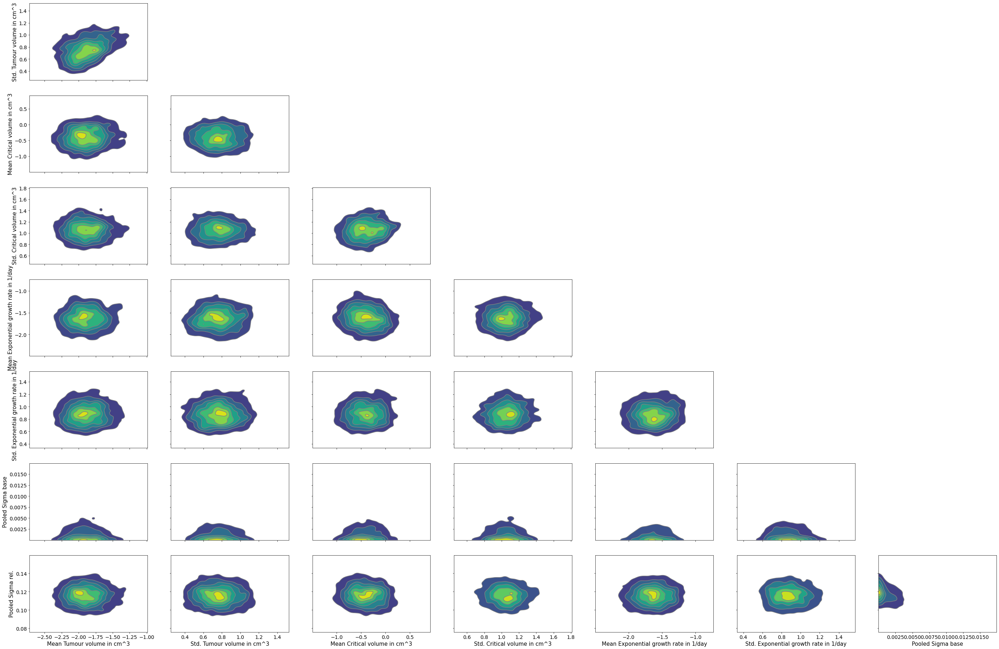

In [50]:
az.plot_pair(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)),
    kind='kde',
    var_names=[
        'Mean Tumour volume in cm^3',
        'Std. Tumour volume in cm^3',
        'Mean Critical volume in cm^3',
        'Std. Critical volume in cm^3',
        'Mean Exponential growth rate in 1/day',
        'Std. Exponential growth rate in 1/day',
        'Pooled Sigma base',
        'Pooled Sigma rel.'])
plt.show()

/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/arviz/plots/backends/matplotlib/pairplot.py:242: UserWarning:

rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid



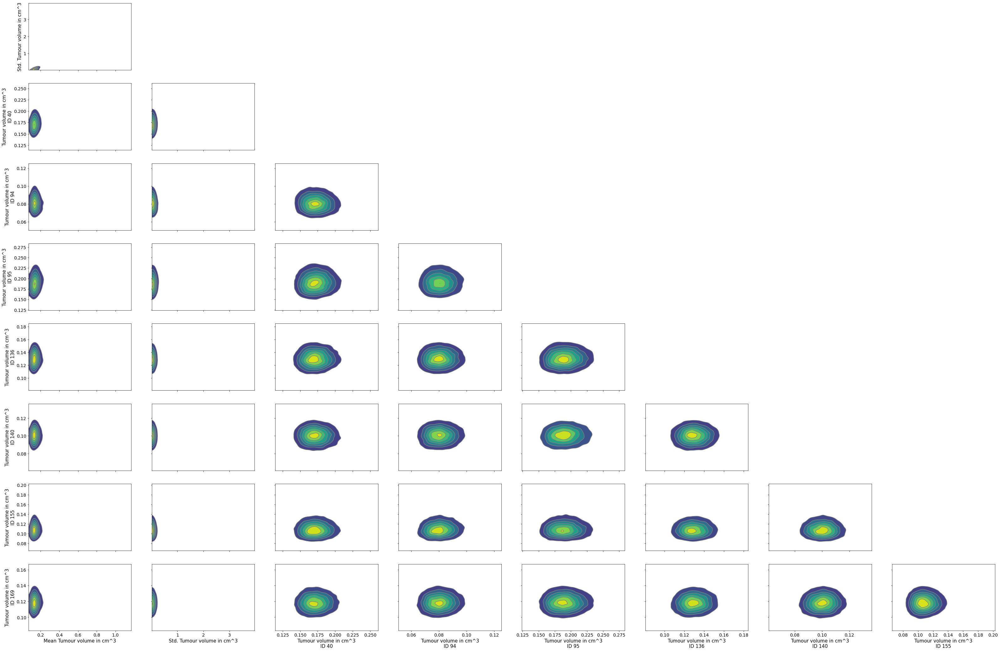

In [17]:
az.plot_pair(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)),
    kind='kde',
    var_names=[
        'Mean Tumour volume in cm^3',
        'Std. Tumour volume in cm^3',
        'Tumour volume in cm^3'])
plt.show()

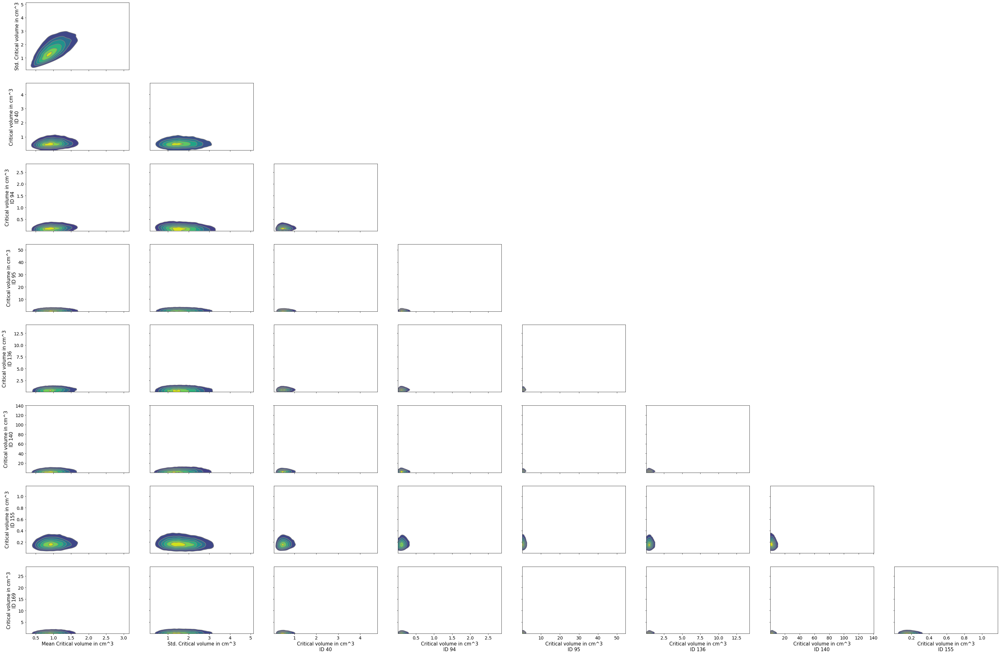

In [18]:
az.plot_pair(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)),
    kind='kde',
    var_names=[
        'Mean Critical volume in cm^3',
        'Std. Critical volume in cm^3',
        'Critical volume in cm^3'])
plt.show()

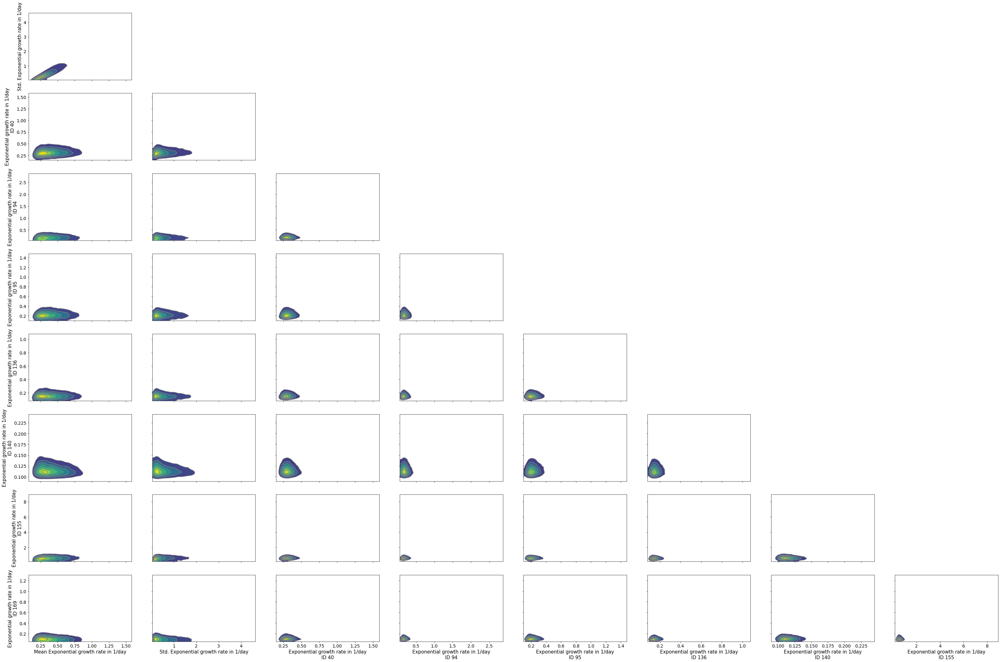

In [19]:
az.plot_pair(
    posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)),
    kind='kde',
    var_names=[
        'Mean Exponential growth rate in 1/day',
        'Std. Exponential growth rate in 1/day',
        'Exponential growth rate in 1/day'])
plt.show()

Safe posterior

In [31]:
# Rename to exportable parameter names
temp = posterior_samples.rename({
    'Tumour volume in cm^3': 'initial_tumour_volume',
    'Mean Tumour volume in cm^3': 'mean_initial_tumour_volume',
    'Std. Tumour volume in cm^3': 'std_initial_tumour_volume',
    'Critical volume in cm^3': 'critical_tumour_volume',
    'Mean Critical volume in cm^3': 'mean_critical_tumour_volume',
    'Std. Critical volume in cm^3': 'std_critical_tumour_volume',
    'Exponential growth rate in 1/day': 'growth_rate',
    'Mean Exponential growth rate in 1/day': 'mean_growth_rate',
    'Std. Exponential growth rate in 1/day': 'std_growth_rate',
    'Pooled Sigma base': 'pooled_sigma_base',
    'Pooled Sigma rel.': 'pooled_sigma_rel'})

# Export
path = os.getcwd()
path = os.path.join(path, 'posteriors', 'population_all_hierarchical_hmc.nc')
temp.sel(draw=slice(warmup, n_iterations, thinning_ratio)).to_netcdf(path)